# Analysis of Daily Activity Data from the BellaBeat Fitness Tracker

The objective of this analysis is to explore the daily activity data collected from the BellaBeat fitness tracker, a product developed by BellaBeat, a company specializing in health-focused smart products. This dataset encompasses various metrics related to users' daily physical activities, including the number of steps taken, distance covered, and calories burned.

Analyzing this data can yield actionable insights to enhance users' physical activity habits, improve product features, and offer better user experiences. This analysis aims to identify patterns and trends in the activity data, pinpoint areas for improvement, and suggest strategies to boost user engagement with BellaBeat products.

## Data Overview

The dataset includes 940 observations across 15 columns. Below is a detailed description of each column:

| Column Name                | Description                                              |
| -------------------------- | -------------------------------------------------------- |
| Id                         | Unique identifier for each record in the dataset         |
| ActivityDate               | Date of the recorded activity                            |
| TotalSteps                 | Total number of steps taken                              |
| TotalDistance              | Total distance covered                                   |
| TrackerDistance            | Distance measured by the fitness tracker                 |
| LoggedActivitiesDistance   | Distance covered during specifically logged activities   |
| VeryActiveDistance         | Distance covered during very active periods              |
| ModeratelyActiveDistance   | Distance covered during moderately active periods        |
| LightActiveDistance        | Distance covered during light activity periods           |
| SedentaryActiveDistance    | Distance covered during sedentary periods                |
| VeryActiveMinutes          | Minutes spent in very active activities                  |
| FairlyActiveMinutes        | Minutes spent in fairly active activities                |
| LightlyActiveMinutes       | Minutes spent in light activities                        |
| SedentaryMinutes           | Minutes spent in sedentary activities                    |
| Calories                   | Total calories burned                                    |

## Analysis Goals

1. **Pattern Recognition**: Identify patterns and trends in the daily activity metrics, such as peak activity times and common activity levels among users.
2. **User Behavior Insights**: Understand how users interact with their fitness trackers and their typical activity patterns.
3. **Product Improvement**: Offer insights that can help improve the BellaBeat fitness tracker’s features and user interface.
4. **User Engagement Strategies**: Suggest strategies to increase user engagement and encourage healthier activity habits.

By thoroughly examining this dataset, we aim to provide comprehensive insights that will help BellaBeat enhance their product and better serve their users.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
from ydata_profiling import ProfileReport
import warnings

%matplotlib inline

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)


---
---

In [2]:
df_daily_activity_merged = pd.read_csv('../data/dailyActivity_merged.csv')

In [3]:
df_daily_activity_merged.shape

(940, 15)

Dataset has 940 observations in 15 columns.

First 5 observations are shown below.

In [4]:
df_daily_activity_merged.head()

,Id,ActivityDate,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories
0,1503960366,4/12/2016,13162,8.50,8.50,0.0,1.88,0.55,6.06,0.0,25,13,328,728,1985
1,1503960366,4/13/2016,10735,6.97,6.97,0.0,1.57,0.69,4.71,0.0,21,19,217,776,1797
2,1503960366,4/14/2016,10460,6.74,6.74,0.0,2.44,0.40,3.91,0.0,30,11,181,1218,1776
3,1503960366,4/15/2016,9762,6.28,6.28,0.0,2.14,1.26,2.83,0.0,29,34,209,726,1745
4,1503960366,4/16/2016,12669,8.16,8.16,0.0,2.71,0.41,5.04,0.0,36,10,221,773,1863


---
---

In [5]:
df_daily_activity_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 940 entries, 0 to 939
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Id                        940 non-null    int64  
 1   ActivityDate              940 non-null    object 
 2   TotalSteps                940 non-null    int64  
 3   TotalDistance             940 non-null    float64
 4   TrackerDistance           940 non-null    float64
 5   LoggedActivitiesDistance  940 non-null    float64
 6   VeryActiveDistance        940 non-null    float64
 7   ModeratelyActiveDistance  940 non-null    float64
 8   LightActiveDistance       940 non-null    float64
 9   SedentaryActiveDistance   940 non-null    float64
 10  VeryActiveMinutes         940 non-null    int64  
 11  FairlyActiveMinutes       940 non-null    int64  
 12  LightlyActiveMinutes      940 non-null    int64  
 13  SedentaryMinutes          940 non-null    int64  
 14  Calories  

Data checked for missing values ✓

It was ascertained sure that all the data is complete and there are no missing pieces. This means that every entry in the dataset has the necessary information, ensuring our analysis is accurate and reliable.

---

Since the "Id" column is an identifier and doesn't hold any numerical meaning,
it will be converted to an object data type.

Note that interesting connections between the ID and other factors could be made,
e.g. IDs starting with certain numbers belong to certain device models, which might
be used for specific activities. However, without being able to verify this with the manufacturer, we will not be able to conduct such an analysis.

In [6]:
df_daily_activity_merged['Id'] = df_daily_activity_merged['Id'].astype(str)

In [7]:
# Convert the 'dates' column to datetime objects with the appropriate format
df_daily_activity_merged['ActivityDate'] = pd.to_datetime(df_daily_activity_merged['ActivityDate'], format='%m/%d/%Y')

# Check the data type of the 'dates' column after conversion
print(df_daily_activity_merged['ActivityDate'].dtype)

datetime64[ns]


Verify data timeframe

In [8]:
# Find the minimum and maximum dates
min_date = df_daily_activity_merged['ActivityDate'].min()
max_date = df_daily_activity_merged['ActivityDate'].max()

# Calculate the difference in days
delta = max_date - min_date

# Print the time range and the difference in days
print('Time range:', min_date, 'to', max_date)
print('Difference is', delta.days, 'days')

Time range: 2016-04-12 00:00:00 to 2016-05-12 00:00:00
Difference is 30 days


The data was collected over the course of one month (30 days)

In [9]:
df_daily_activity_merged.describe()

,ActivityDate,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories
count,940,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000
mean,2016-04-26 06:53:37.021276672,7637.910638,5.489702,5.475351,0.108171,1.502681,0.567543,3.340819,0.001606,21.164894,13.564894,192.812766,991.210638,2303.609574
min,2016-04-12 00:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2016-04-19 00:00:00,3789.750000,2.620000,2.620000,0.000000,0.000000,0.000000,1.945000,0.000000,0.000000,0.000000,127.000000,729.750000,1828.500000
50%,2016-04-26 00:00:00,7405.500000,5.245000,5.245000,0.000000,0.210000,0.240000,3.365000,0.000000,4.000000,6.000000,199.000000,1057.500000,2134.000000
75%,2016-05-04 00:00:00,10727.000000,7.712500,7.710000,0.000000,2.052500,0.800000,4.782500,0.000000,32.000000,19.000000,264.000000,1229.500000,2793.250000
max,2016-05-12 00:00:00,36019.000000,28.030001,28.030001,4.942142,21.920000,6.480000,10.710000,0.110000,210.000000,143.000000,518.000000,1440.000000,4900.000000
std,NaN,5087.150742,3.924606,3.907276,0.619897,2.658941,0.883580,2.040655,0.007346,32.844803,19.987404,109.174700,301.267437,718.166862


How many unique IDs (users) are there in the dataset?

In [10]:
unique_ids = df_daily_activity_merged['Id'].nunique()
unique_ids

33

The number of unique IDs in the dataset is 33. Since the dataset description mentioned 30 users it is unclear if the discrepancy is because of an inaccuracy when specifying the number. Online research suggests that Bellabeat does not give out multiple IDs for users with multiple devices. So it is unlikely that users with multiple devices resulted in the discrepancy. Thus the discrepancy is currently not known to negatively influence the analysis in any way.

---
---
## Data profiling

### YData-Profiling

YData-Profiling, formerly known as Pandas Profiling, is an automated data analysis tool that generates comprehensive reports on datasets. It provides valuable insights, statistical summaries, and visualizations, helping data scientists and analysts understand their data quickly and effectively. It is useful for tasks like data preprocessing, quality assessment, and exploratory analysis, providing a solid foundation for further analysis and decision-making.

In [11]:
# Assuming df_daily_activity_merged is already defined
# Create the profile report
profile = ProfileReport(df_daily_activity_merged, title="Daily Activity Report", explorative=True)

# Save the report as an HTML file
profile.to_file("../reports/pandas_profiling_report.html")

# Display the report within the notebook (optional)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

---

To clearly comment on the most important results of the data-profiling, they will be repeated here.

The duration of Bellabeat device usage during the data collection period is crucial for interpreting the analysis, as days with no recorded activity indicate that the user was not wearing the device.

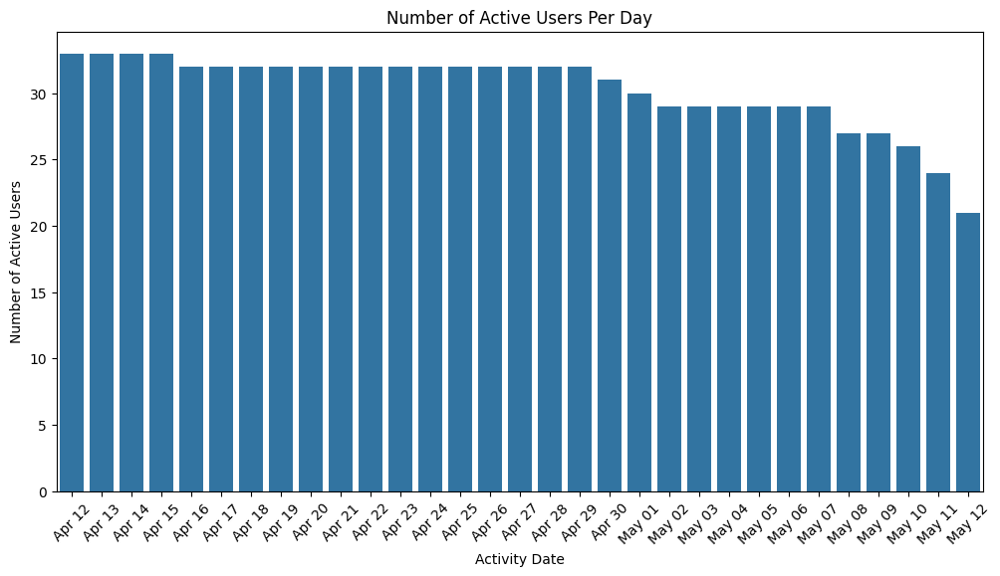

In [12]:
# Group the data by date and count the number of unique users each day
user_activity_by_date = df_daily_activity_merged.groupby('ActivityDate')['Id'].nunique().reset_index()

# Format the date in the 'ActivityDate' column to remove the year
user_activity_by_date['ActivityDate'] = user_activity_by_date['ActivityDate'].dt.strftime('%b %d')

# Create the second bar plot with the same blue color
plt.figure(figsize=(12, 6))
sns.barplot(data=user_activity_by_date, x='ActivityDate', y='Id', color="#1f77b4")
plt.xlabel('Activity Date')
plt.ylabel('Number of Active Users')
plt.title('Number of Active Users Per Day')
plt.xticks(rotation=45)
plt.show()

The histogram shows that all 33 users wore their devices at the beginning of the data collection period. However, towards the end, a third of the users had stopped wearing their devices. Encouraging users to wear their devices more consistently using personalized reminders and motivational incentives could help improve user engagement and ensure more consistent data collection.

---

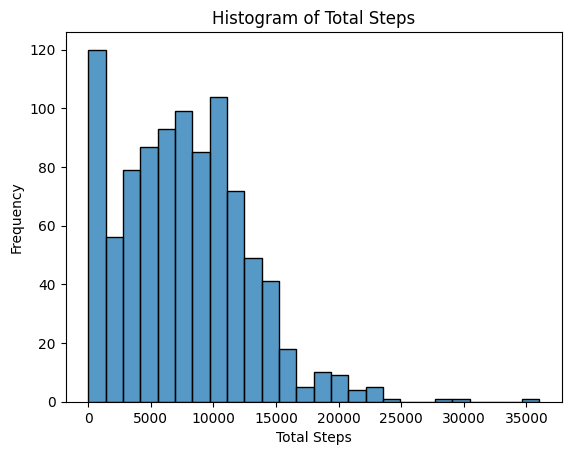

Range of the smallest bin: 3601.9


In [13]:
# Histogram of "total_steps" using Seaborn
sns.histplot(data=df_daily_activity_merged, x='TotalSteps')
plt.xlabel('Total Steps')
plt.ylabel('Frequency')
plt.title('Histogram of Total Steps')
plt.show()

# Get the histogram bins
hist, bins = np.histogram(df_daily_activity_merged['TotalSteps'])

# Calculate the range of the smallest bin
smallest_bin_range = bins[1] - bins[0]
print("Range of the smallest bin:", smallest_bin_range)

The histogram reveals that the majority of observations exhibit a low number of daily steps, typically falling within the range of 0 to approximately 3600.

---

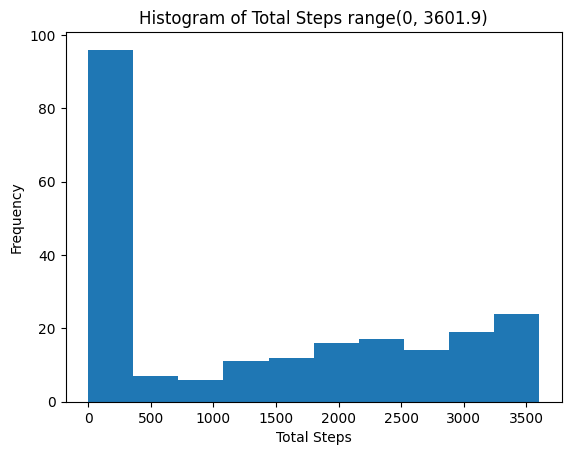

In [14]:
# Create a histogram with multiple bins within the range of 0 to 3601.9
plt.hist(df_daily_activity_merged['TotalSteps'], bins=10, range=(0, 3601.9))
plt.xlabel('Total Steps')
plt.ylabel('Frequency')
plt.title('Histogram of Total Steps range(0, 3601.9)')
plt.show()

In [15]:
df_daily_activity_merged[df_daily_activity_merged['TotalSteps'] == 0].shape[0]

77

Splitting up the smallest bin into finer bins suggests that the majority of the low values are from days on which the user didn't wear the device at all, or very little.

The number of observations where the device recorded 0 steps for the whole day (**Zero Days**) is 77.

---

### Correlation Heatmap

A correlation heatmap is a visual tool that helps us understand the relationships between different variables in a dataset. Imagine you want to see how various factors, like different types of activities or measurements, relate to each other. The heatmap shows these relationships using colors:
- **Dark colors** (closer to blue) show stronger positive relationships, meaning as one variable increases, the other tends to increase as well.
- **Light colors** (closer to red) indicate weaker or even negative relationships, meaning as one variable increases, the other might decrease or not change much.

By looking at the heatmap, we can quickly see which variables are closely linked and which are not, helping us understand overall patterns and interactions in the data. This tool simplifies complex data, making it easier to spot trends and relationships at a glance.

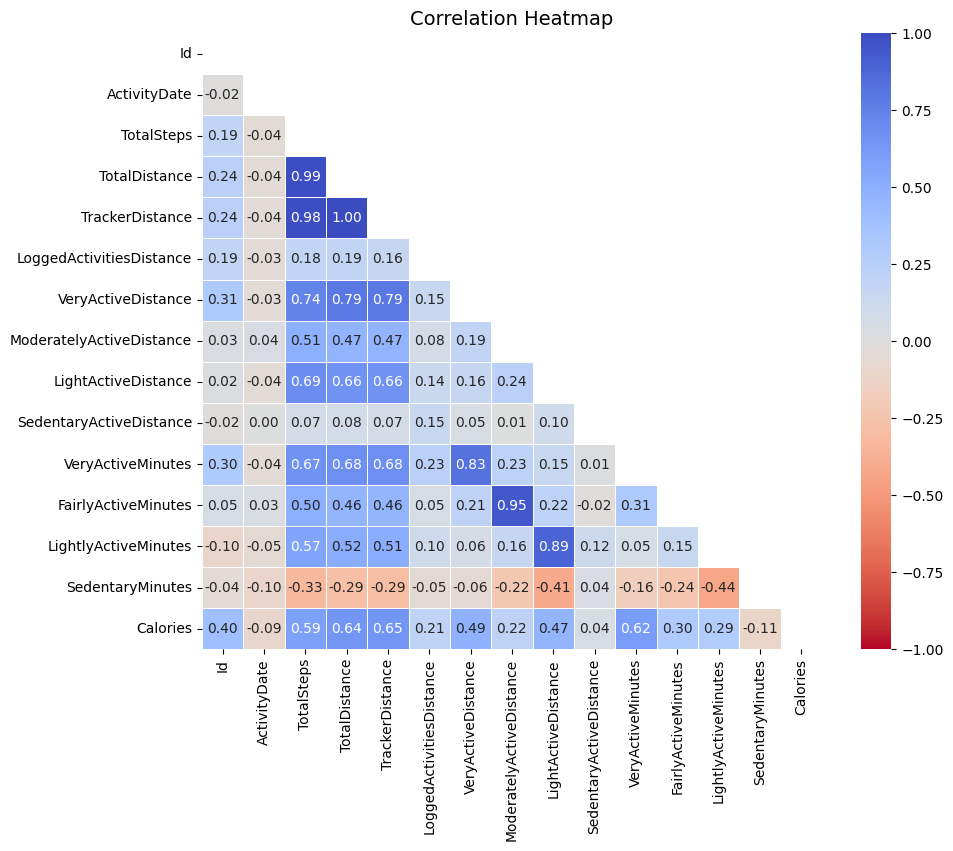

In [16]:
# Calculate the correlation matrix
correlation_matrix = df_daily_activity_merged.corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))

# Plot the correlation heatmap with the masked upper triangle
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm_r", vmin=-1, vmax=1, center=0, linewidths=0.5, mask=mask)

plt.title("Correlation Heatmap", fontsize=14)
plt.show()

### Analysis of Correlation Heatmap

**Similarity in Activity Metrics:**
   - **High Correlation**: Metrics such as `TotalSteps`, `TotalDistance`, and `TrackerDistance` exhibit remarkably high correlation coefficients, indicating that these measures are closely related and might be used interchangeably for certain analyses. This suggests that when one of these metrics increases, the others tend to increase as well, reflecting consistent tracking of user movement.

**Sensor Data Consistency:**
   - **Strong Correlations Among Activity Levels**: There are strong correlations among the various active distance and active minutes categories, such as `VeryActiveDistance`, `ModeratelyActiveDistance`, `LightActiveDistance`, `VeryActiveMinutes`, `FairlyActiveMinutes`, and `LightlyActiveMinutes`. This consistency implies the reliability and accuracy of the sensor data, demonstrating the device's capability to effectively capture different levels of physical activity.

**Calories Expenditure Patterns:**
   - **Calorie Correlation with Activity**: The `Calories` metric shows a strong correlation with `TotalSteps`, `TotalDistance`, and `TrackerDistance`, as well as with the "VeryActive" categories. This suggests that the device is proficient in estimating calorie expenditure during more intense physical activities. The strong correlation with higher-intensity metrics underscores the importance of vigorous activity in calorie burning, which can be crucial for users tracking their fitness and health goals.

**Integrated Insights:**
   - **Interrelated Activity Metrics**: The high correlations between `TotalSteps`, `TotalDistance`, and `TrackerDistance` highlight their interrelated nature, suggesting that any one of these metrics could serve as a reliable indicator of overall activity levels.
   - **Effective Sensor Functionality**: The robust correlations among different intensity and active minute categories affirm the device’s effective functionality in capturing varying activity intensities, ensuring users can trust the data accuracy.
   - **Calorie Tracking Efficiency**: The correlation between `Calories` and more vigorous activity metrics indicates that the device accurately tracks calorie expenditure during high-intensity activities, providing users with valuable insights into their fitness routines.

In summary, the correlation heatmap underscores the interconnectedness of various activity metrics, the accuracy and reliability of the sensor data in capturing different activity intensities, and the device’s effectiveness in estimating calorie expenditure, especially during intense activities. These insights are vital for users aiming to monitor and enhance their health and fitness activities comprehensively.

---
---
#### Plotting the data for a random Id, here 1503960366 to get a feel for the data

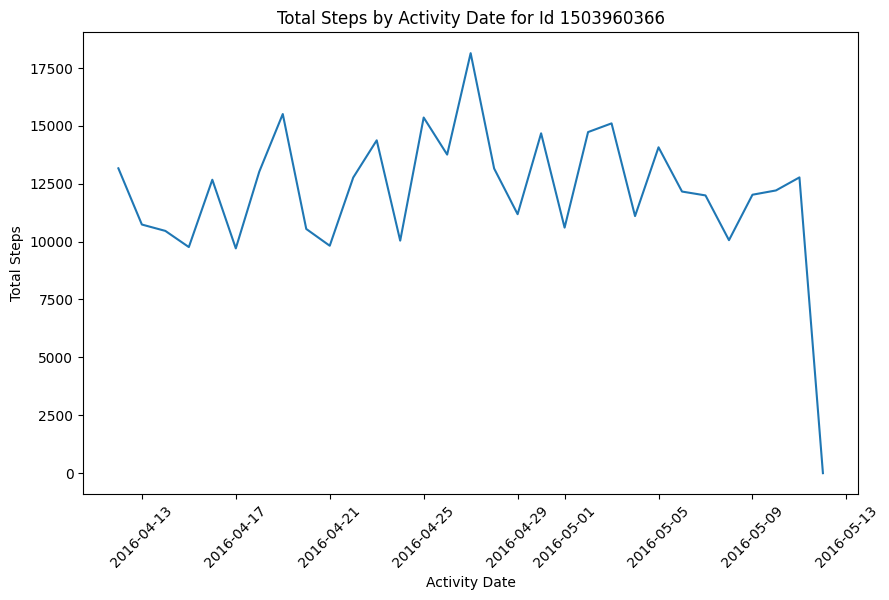

In [17]:
# Filter rows where Id is 1503960366
filtered_df = df_daily_activity_merged[df_daily_activity_merged['Id'] == '1503960366']

# Extract the TotalSteps and ActivityDate columns
total_steps = filtered_df['TotalSteps']
activity_date = filtered_df['ActivityDate']

# Plot TotalSteps against ActivityDate
plt.figure(figsize=(10, 6))
plt.plot(activity_date, total_steps)
plt.xlabel('Activity Date')
plt.ylabel('Total Steps')
plt.title('Total Steps by Activity Date for Id 1503960366')
plt.xticks(rotation=45)
plt.show()


Let's check if the total steps are 0 for the 6 users with the lowest ID number for the last logged date. Maybe the device wasn't able to capture a whole day of data on the last day and thus returned 0.

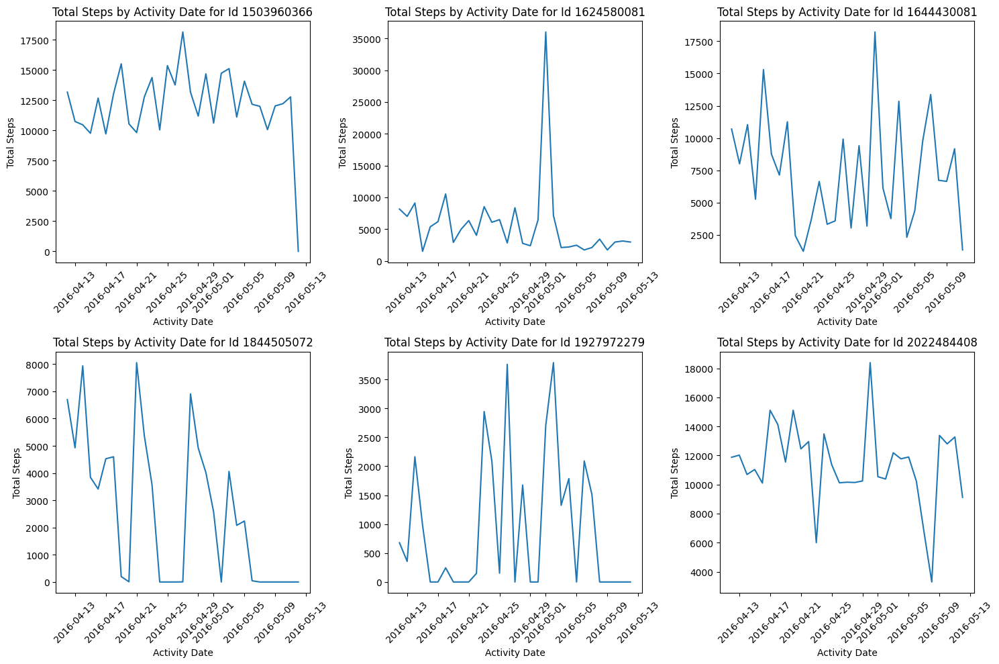

In [18]:
unique_ids = df_daily_activity_merged['Id'].unique()[:6]
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))
for i, user_id in enumerate(unique_ids):
    # Filter rows where Id is user_id
    filtered_df = df_daily_activity_merged[df_daily_activity_merged['Id'] == user_id]

    # Extract the TotalSteps and ActivityDate columns
    total_steps = filtered_df['TotalSteps']
    activity_date = filtered_df['ActivityDate']

    # Plot TotalSteps against ActivityDate in the corresponding subplot
    ax = axes[i // 3, i % 3]
    ax.plot(activity_date, total_steps)
    ax.set_xlabel('Activity Date')
    ax.set_ylabel('Total Steps')
    ax.set_title(f'Total Steps by Activity Date for Id {user_id}')
    ax.tick_params(axis='x', rotation=45)

# Adjust the spacing between subplots
plt.tight_layout()

# Display the plots
plt.show()


### Analysis of User Activity Data

The line plots above show the total steps taken by different users over time. Here are some key observations:

1. **Inactive Days**: Not all users had zero steps on the last date of data collection. "0 days" are probably the result of the user not wearing their device. **We will analyze how many of them there were next**.

2. **Activity Patterns**: Users show varied daily activity, with some consistent and others fluctuating. Peaks and troughs reflect different daily routines.

3. **Significant Activity Peaks**:
   - **35,000 Steps Peak**: One user has a significant peak at 35,000 steps, likely due to a special event or an exceptionally active day. Recognizing and celebrating such achievements can motivate users.

### Suggestions for Encouraging User Engagement
- **Recognize Active Days**: Celebrate highly active days to motivate users.
- **Monitor Inactivity**: Remind users to wear their device on inactive days.
- **Personalized Insights**: Offer personalized feedback based on activity patterns to help users achieve their fitness goals.

By analyzing these patterns and encouraging positive behavior, we can help users stay motivated and improve their overall physical activity levels.

In [19]:
# Filter rows where "total_steps" is 0
zero_steps_df = df_daily_activity_merged[df_daily_activity_merged['TotalSteps'] == 0]

# Group by "id" and count the number of rows for each user
zero_steps_count = zero_steps_df.groupby('Id').size()

print(zero_steps_count)

Id
1503960366     1
1844505072    10
1927972279    14
4020332650    14
4057192912     1
4702921684     1
5577150313     2
6117666160     5
6290855005     5
6775888955     9
7007744171     2
7086361926     1
8253242879     1
8583815059     1
8792009665    10
dtype: int64


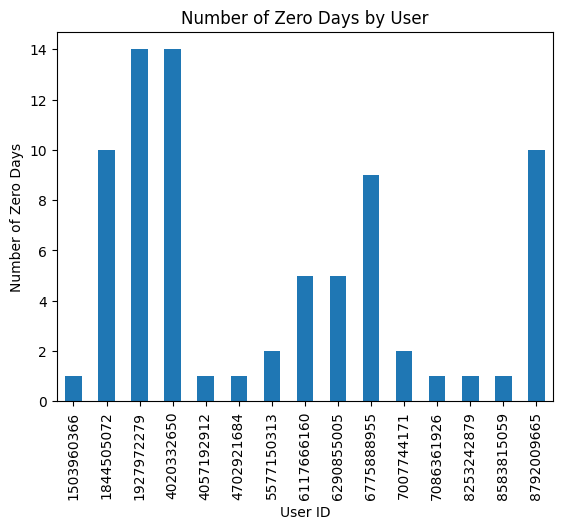

In [20]:
# Filter rows where "total_steps" is 0
zero_steps_df = df_daily_activity_merged[df_daily_activity_merged['TotalSteps'] == 0]

# Group by "id" and count the number of rows for each user
zero_steps_count = zero_steps_df.groupby('Id').size()

# Plotting the bar chart
zero_steps_count.plot(kind='bar')
plt.xlabel('User ID')
plt.ylabel('Number of Zero Days')
plt.title('Number of Zero Days by User')
plt.show()

### Analysis of User Zero Days

1. **Varied Engagement**: Some users, like those with IDs 1927972279 and 4020332650, had many zero days (around 14), indicating lower engagement or periods when the device was not worn. Others had very few or no zero days, suggesting consistent use.
2. **User-Specific Patterns**: Different users show different patterns of device usage. Understanding why certain users are more consistent can help in designing strategies to improve overall user engagement.

### Recommendations
- **Encourage Consistent Use**: Providing reminders or incentives for wearing the device daily could help reduce the number of zero days.
- **Understand Barriers**: Investigate why some users have high numbers of zero days. Are there issues with comfort, battery life, or other factors that could be addressed?

By recognizing patterns in device usage and addressing barriers, we can improve user engagement and ensure more accurate activity tracking.

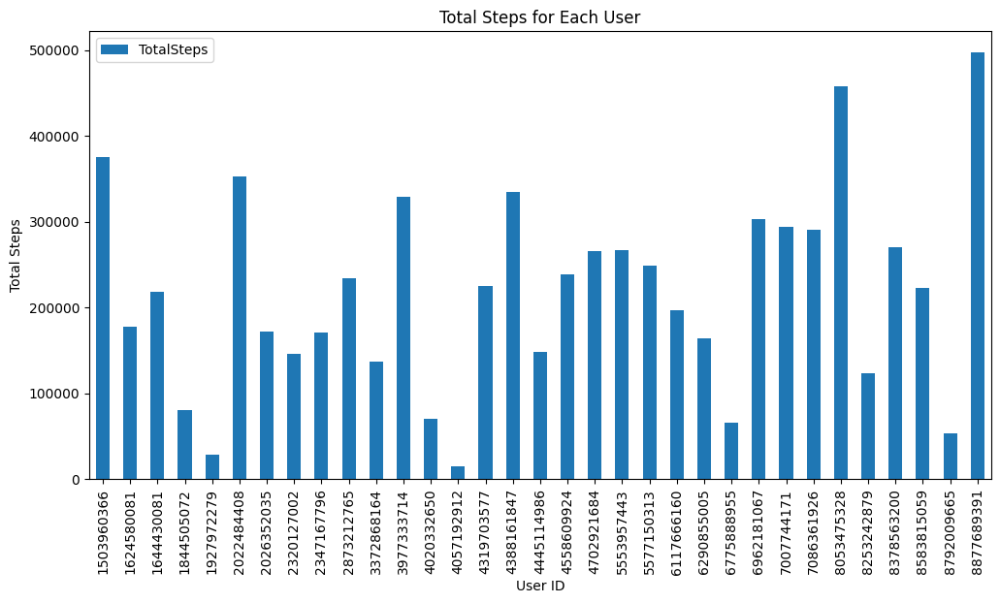

In [21]:
grouped_df = df_daily_activity_merged.groupby("Id").agg({"TotalSteps": "sum"})

grouped_df.plot(kind="bar", figsize=(12, 6))
plt.xlabel("User ID")
plt.ylabel("Total Steps")
plt.title("Total Steps for Each User")
plt.show()


### Total Steps by User

The bar chart above illustrates the total steps taken by each user in the dataset. Here are some key observations:

1. **Diverse Activity Levels**: Users exhibit a wide range of total steps, from less than 50,000 steps to over 500,000 steps, indicating varied levels of physical activity among the users.
2. **Highly Active Users**: Some users, like those with IDs 8777689391 and 2022484408, recorded exceptionally high step counts, showcasing their high levels of activity.
3. **Less Active Users**: Conversely, users like those with IDs 629085005 and 4319703577 had significantly lower total step counts, which might suggest lower engagement or different activity habits.

### Recommendations
- **Encourage Consistent Activity**: Highlighting the achievements of highly active users can motivate others to increase their activity levels.
- **Identify Barriers**: For users with lower step counts, understanding potential barriers (like device comfort or usability) can help improve engagement.
- **Personalized Goals**: Setting personalized step goals based on past activity levels can help users gradually increase their daily steps and stay motivated.

By analyzing these patterns, we can better understand user behavior and provide tailored recommendations to help all users achieve their fitness goals.

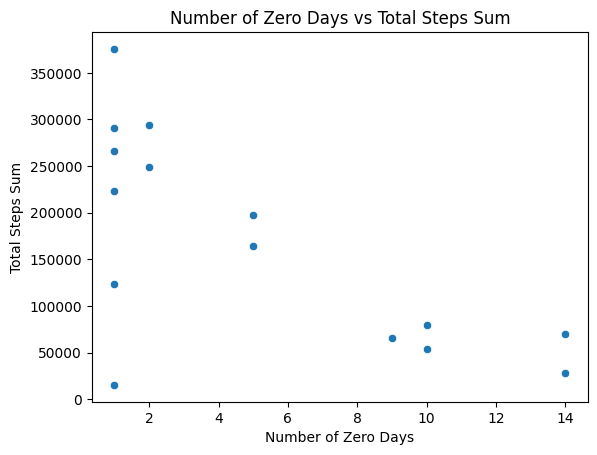

In [22]:
# Group by "id" and calculate the sum of "total_steps" for each user
steps_sum = df_daily_activity_merged.groupby('Id')['TotalSteps'].sum().reset_index()

# Merge with the counts of zero days for each user
merged_df = pd.merge(steps_sum, zero_steps_df.groupby('Id').size().reset_index(), on='Id')
merged_df.columns = ['Id', 'TotalSteps_sum', 'zero_days_count']

# Plotting the scatter plot
sns.scatterplot(data=merged_df, x='zero_days_count', y='TotalSteps_sum')
plt.xlabel('Number of Zero Days')
plt.ylabel('Total Steps Sum')
plt.title('Number of Zero Days vs Total Steps Sum')
plt.show()

### Number of Zero Days vs Total Steps Sum

This scatter plot illustrates the general trend that users with fewer zero days tend to accumulate more steps overall. Most users follow this pattern, with higher step counts associated with fewer zero days. However, there is a notable outlier at the bottom left, where a user has very few zero days but still a relatively low total step count. This outlier could indicate unique user behavior or other influencing factors.

### Key Observations
- **General Trend**: Fewer zero days correlate with higher total step counts.
- **Outlier**: One user with few zero days still has low total steps, suggesting atypical activity patterns or other factors.

Understanding these patterns helps identify consistent users and those with unique behaviors, providing insights for tailored engagement strategies.

In [23]:
# Sort by "total_steps" in ascending order and get the first row
first_row = steps_sum.sort_values(by="TotalSteps", ascending=True).head(1).reset_index(drop=True)

# Convert the DataFrame to string and hide the index
first_row_str = first_row.to_string(index=False)

print(first_row_str)

        Id  TotalSteps
4057192912       15352


Let's analyze the aforementioned outlier. The user with the id 4057192912. Let's analyze his activity patterns in more detail. Furthermore it will be interesting to see if larger datasets with more users contain more of such user behaviour. Wearing the BellaBeat device continuosly but not being very active while doing so. Such users could maybe be motivated by targeted marketing campaigns and notifications to increase their activity. This might lead to health benefits and thus customer satisfaction and retention.

Also as an alternative to the static approach we took above to find out the user 4057192912, we can generate an interactive plotly graph and hover over the datapoint to find out the id.

In [24]:
# Creating an interactive scatter plot with hover information
fig = px.scatter(merged_df, x='zero_days_count', y='TotalSteps_sum', hover_data=['Id'])
fig.update_layout(
    title='Number of Zero Days vs Total Steps Sum',
    xaxis_title='Number of Zero Days',
    yaxis_title='Total Steps Sum'
)
fig.show()

Further analysis of user 4057192912 to analyze activity patterns

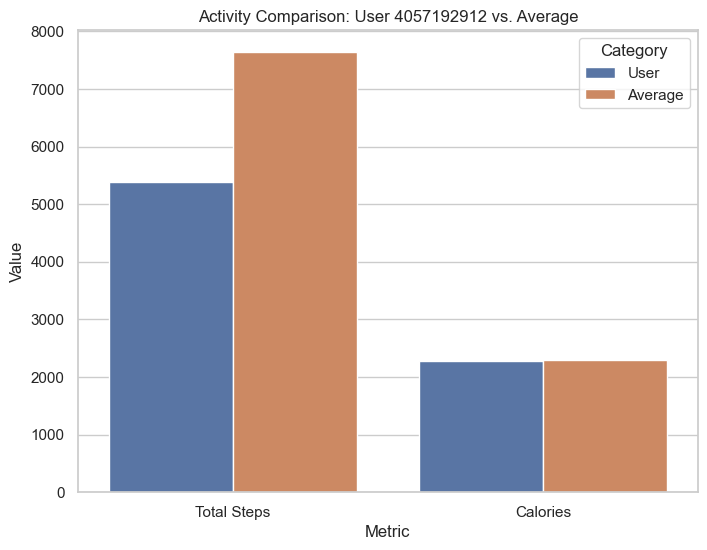

In [25]:
# Filter the DataFrame for user '4057192912'
user_data = df_daily_activity_merged[df_daily_activity_merged['Id'] == '4057192912']

# Calculate the average values for the entire dataset
avg_steps = df_daily_activity_merged['TotalSteps'].mean()
avg_calories = df_daily_activity_merged['Calories'].mean()

# Get the values for user '4057192912'
user_steps = user_data['TotalSteps'].values[0]
user_calories = user_data['Calories'].values[0]

# Create a DataFrame for comparison
comparison_data = pd.DataFrame({
    'Metric': ['Total Steps', 'Calories'],
    'User': [user_steps, user_calories],
    'Average': [avg_steps, avg_calories]
})

# Plot the comparison using seaborn
sns.set(style='whitegrid')
plt.figure(figsize=(8, 6))
sns.barplot(x='Metric', y='Value', hue='Category', data=comparison_data.melt('Metric', var_name='Category', value_name='Value'))
plt.title('Activity Comparison: User 4057192912 vs. Average')
plt.xlabel('Metric')
plt.ylabel('Value')
plt.show()

The plot compares the activity metrics of a specific user (User 4057192912) with the average of the user community. It shows that this user takes fewer total steps but burns a similar number of calories compared to the average.

Providing similar graphs to users via an app could enable them to compare their activity levels with the community. This feature could serve as a motivational tool, encouraging users to increase their physical activity by aiming to match or exceed community averages.

---
---

## Business recommendations


Too many users on too many days don't wear their device at all. 
To encourage users to wear device more often, we should consider these techniques:

1. Encourage users to set achievable goals and track progress.
2. Use gamification elements like rewards and challenges.
3. Incorporate social features for support and accountability.
4. Send reminders and notifications to wear the device.
5. Provide personalized insights and recommendations.
6. Organize challenges and offer incentives. For example, users could be eligible for competitions with sports equipment as rewards if they achieve a certain activity threshold.
7. Educate users about the benefits of wearing devices.
8. Stay updated with new features and innovations.
